# IMDB regression

For this project, we have a database consisting of a number of movies with several data features. Our task is to create a model that serves to predict the imdb score a movie will get based on its stats.


## Data Exploration

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport

db_path = "https://raw.githubusercontent.com/manlio99/Materia-de-aprendizaje/master/3_MidtermProjects/ProjectIMDB/data/movie_metadata.csv"

df = pd.read_csv(db_path).drop(["color"], axis=1).dropna().drop_duplicates()

profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Analysis 

From the report, we can detect a number of features that are not really interesting to our analysis. There are other features that we can prescind. For example, those that have a strong correlation with each other.

<Axes: >

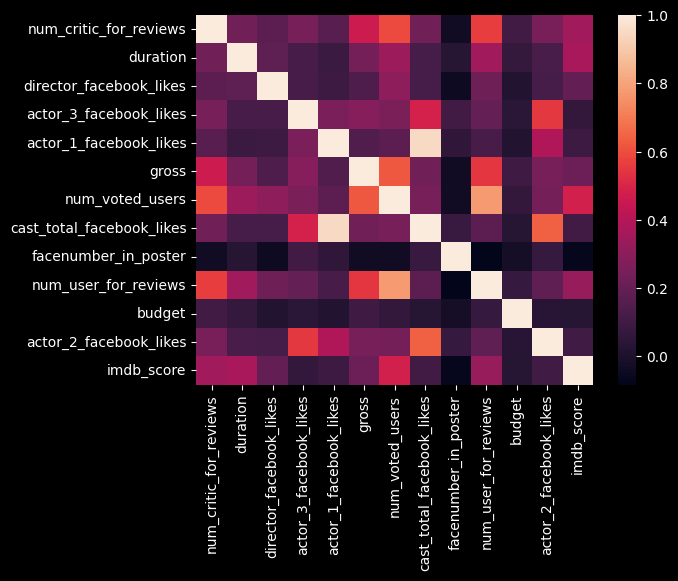

In [2]:
df.head()

numerical = df.loc[
    :,
    [
        "num_critic_for_reviews",
        "duration",
        "director_facebook_likes",
        "actor_3_facebook_likes",
        "actor_1_facebook_likes",
        "gross",
        "num_voted_users",
        "cast_total_facebook_likes",
        "facenumber_in_poster",
        "num_user_for_reviews",
        "budget",
        "actor_2_facebook_likes",
        "imdb_score",
    ],
]
sns.heatmap(numerical.corr())

<Axes: >

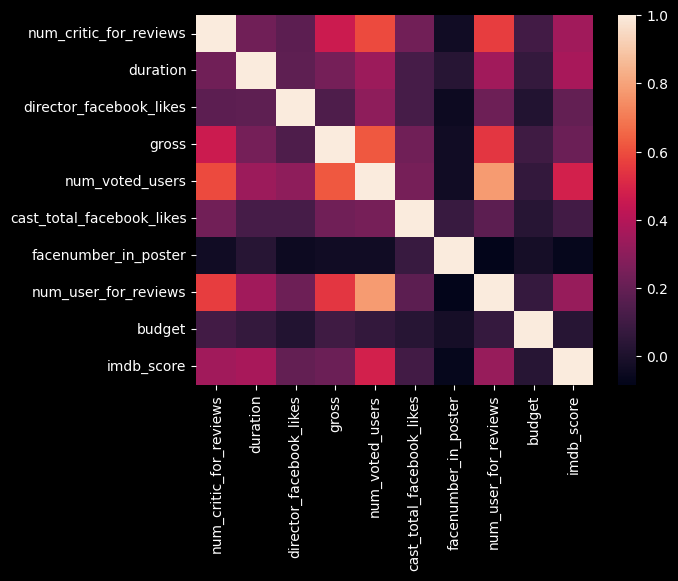

In [3]:
numerical.drop(
    ["actor_3_facebook_likes", "actor_1_facebook_likes", "actor_2_facebook_likes"],
    axis=1,
    inplace=True,
)
sns.heatmap(numerical.corr())

## Model Partition

Now that we have detected the features of the dataset that we want to use. We will split our dataset, and train a linear regression model.

R2 score: 0.33940150741231934
<class 'numpy.ndarray'>


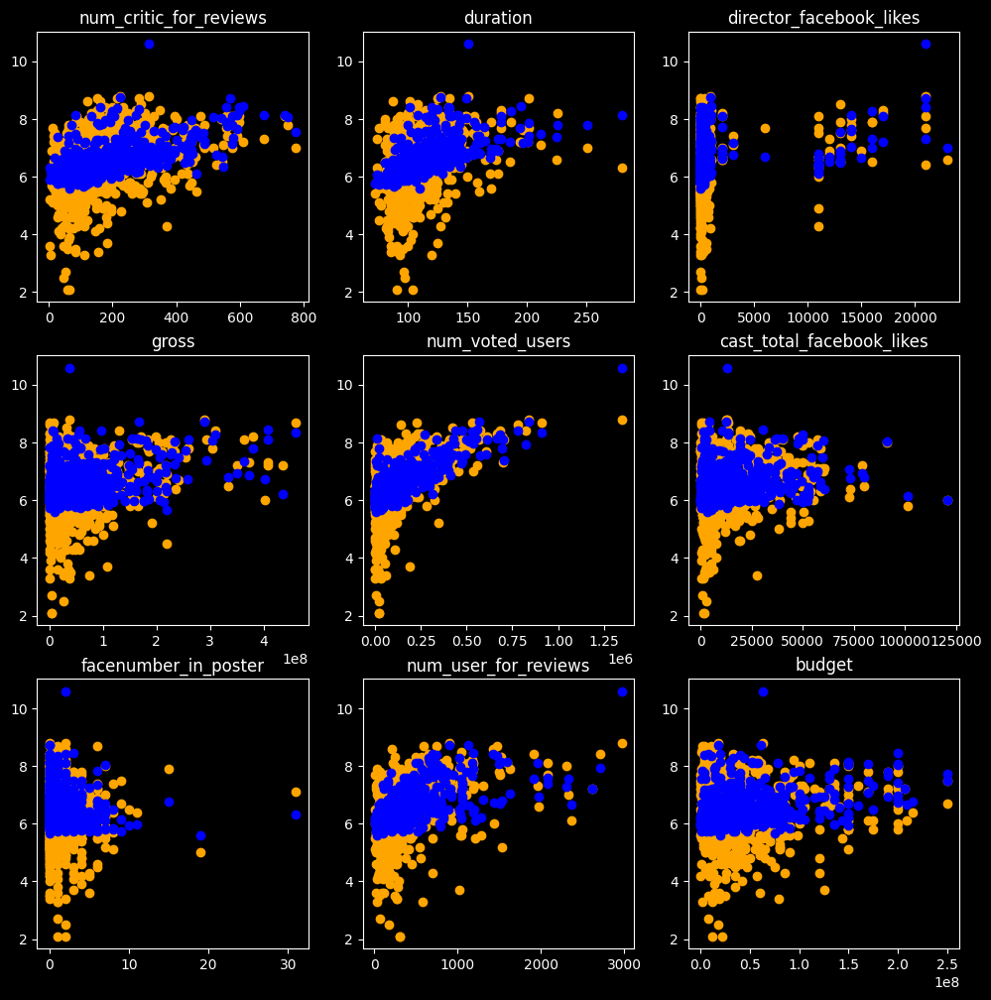

In [17]:
import itertools
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

# Dataframe for regression
dfr = numerical.copy()

y = dfr.pop("imdb_score")
X = dfr
X_train, X_test, y_train, y_test = train_test_split(
    X, y, train_size=0.8, test_size=0.2, random_state=314
)

lm = LinearRegression()
lm.fit(X_train, y_train)

y_pred = lm.predict(X_test)

linearR2 = r2_score(y_test, y_pred)

print("R2 score: " + str(linearR2))

rows, columns = 3, 3
figure, axis = plt.subplots(3, 3, figsize=(12, 12))

# plot the test and predicted values for each of the features

print(type(axis[1]))

for row, column in itertools.product(range(rows), range(columns)):

    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_test, color="orange"
    )
    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_pred, color="blue"
    )
    axis[row, column].set_title(X_test.columns[row * columns + column])


plt.show()

## Linear regression results

In the plot, we can see the relation between the expected / test values (orange) and the predicted values (blue), for each of the features of our model.

We can see that we have a good regression performance for values around 6 and above. However, for low values, the predictive value is limited.

Overall the performance of our model is low with a R2 of .34. Let's train different models and compare results.

R2 score: 0.12141551413643792


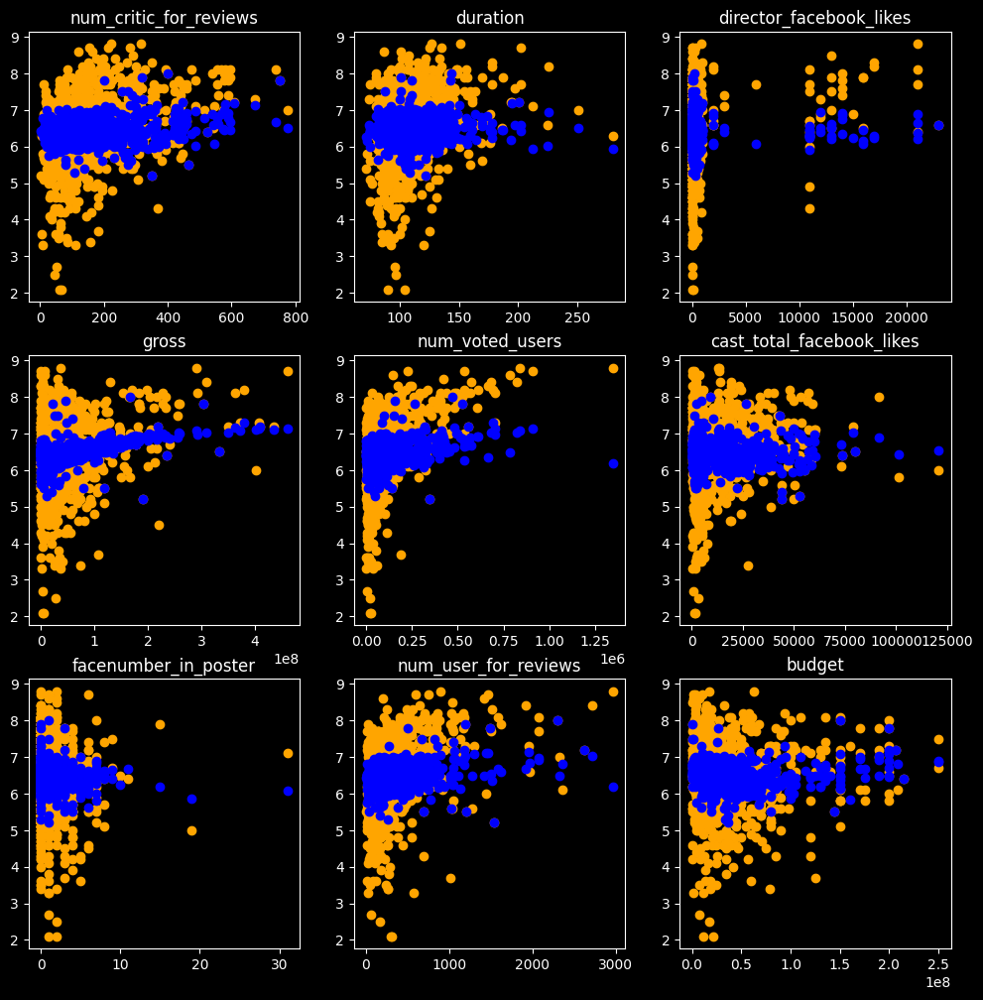

In [18]:
from sklearn import neighbors

knn = neighbors.KNeighborsRegressor(350, weights="distance")
y_pred = knn.fit(X_train, y_train).predict(X_test)

knnR2 = r2_score(y_test, y_pred)

print("R2 score: " + str(knnR2))

rows, columns = 3, 3
figure, axis = plt.subplots(3, 3, figsize=(12, 12))

# plot the test and predicted values for each of the features

for row, column in itertools.product(range(rows), range(columns)):

    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_test, color="orange"
    )
    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_pred, color="blue"
    )
    axis[row, column].set_title(X_test.columns[row * columns + column])

plt.show()

R2 score: 0.5466070520437136


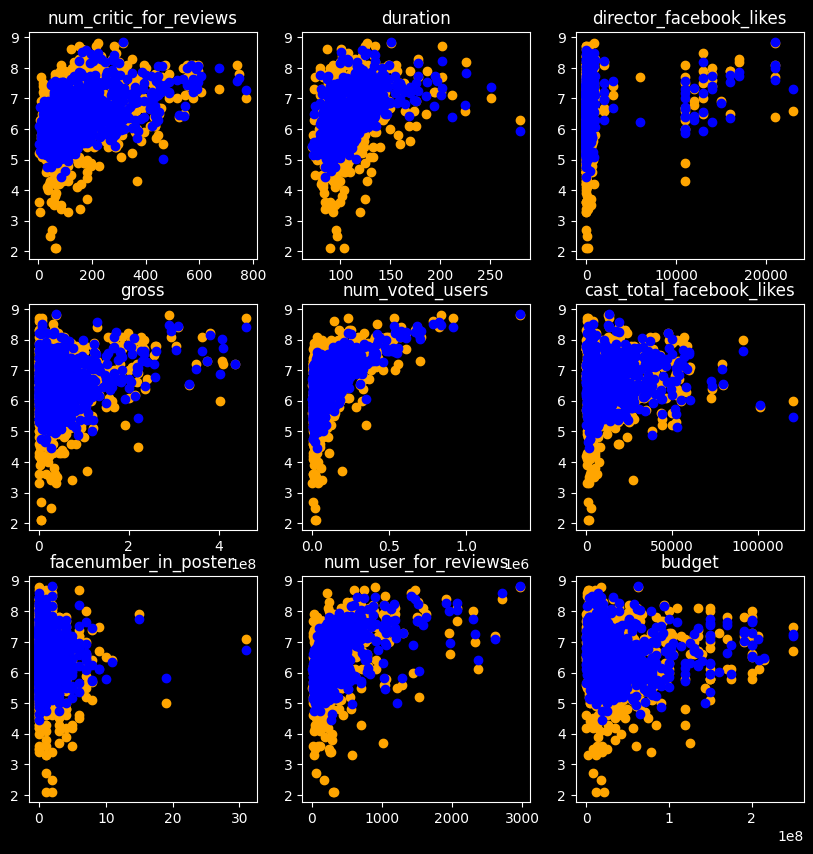

In [19]:
from sklearn.ensemble import RandomForestRegressor

regr = RandomForestRegressor(min_samples_leaf=2, n_estimators=100, random_state=42)
y_pred = regr.fit(X_train, y_train).predict(X_test)

rForestR2 = r2_score(y_test, y_pred)

print("R2 score: " + str(rForestR2))

rows, columns = 3, 3
figure, axis = plt.subplots(3, 3, figsize=(10, 10))

# plot the test and predicted values for each of the features

for row, column in itertools.product(range(rows), range(columns)):

    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_test, color="orange"
    )
    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_pred, color="blue"
    )
    axis[row, column].set_title(X_test.columns[row * columns + column])

plt.show()

In [30]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    "n_estimators": [10, 50, 100, 200],
    "max_depth": [None, 5, 10],
    "min_samples_split": [2, 5, 7],
    "min_samples_leaf": [1, 2, 4],
    "bootstrap": [False, True],
}

grid_search = GridSearchCV(
    estimator=regr,
    param_grid=param_grid,
    cv=5,
    scoring="neg_mean_squared_error",
)

# Perform the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_

print("Best Parameters:", best_params)
print("Best Estimator:", best_estimator)

# Best Parameters: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
# Best Estimator: RandomForestRegressor(max_features='sqrt', n_estimators=200, random_state=42)

Best Parameters: {'bootstrap': True, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
Best Estimator: RandomForestRegressor(max_features='sqrt', n_estimators=200, random_state=42)


R2 score: 0.5518985862641372


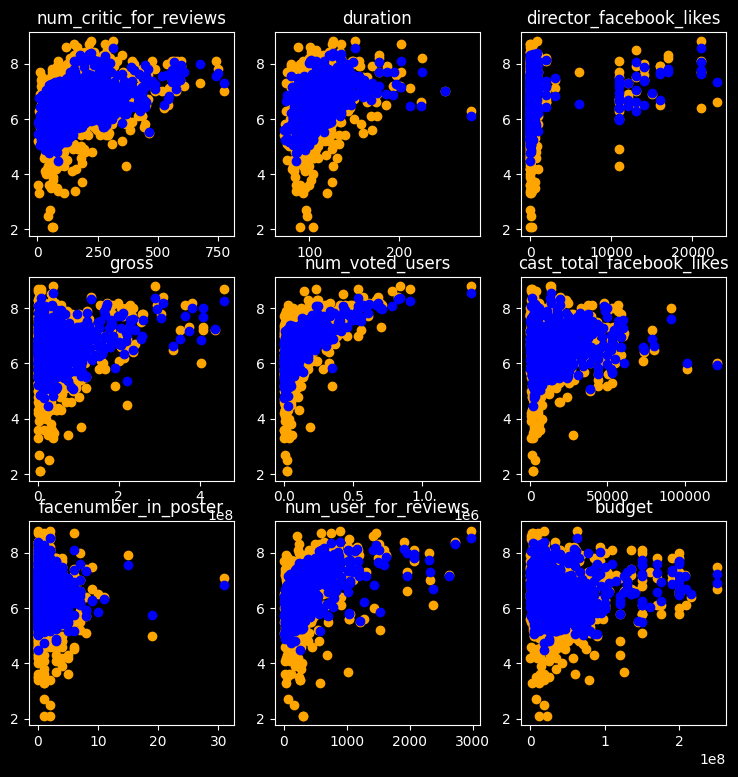

In [20]:
regr =  RandomForestRegressor(max_depth=None, max_features='sqrt', n_estimators=200, random_state=42, min_samples_leaf= 1, min_samples_split= 2)
y_pred = regr.fit(X_train, y_train).predict(X_test)

rForestTunedR2 = r2_score(y_test, y_pred)

print("R2 score: " + str(rForestTunedR2))

rows, columns = 3, 3
figure, axis = plt.subplots(3, 3, figsize=(9, 9))

# plot the test and predicted values for each of the features

for row, column in itertools.product(range(rows), range(columns)):

    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_test, color="orange"
    )
    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_pred, color="blue"
    )
    axis[row, column].set_title(X_test.columns[row * columns + column])

plt.show()

R2 score: 0.5317380882482067


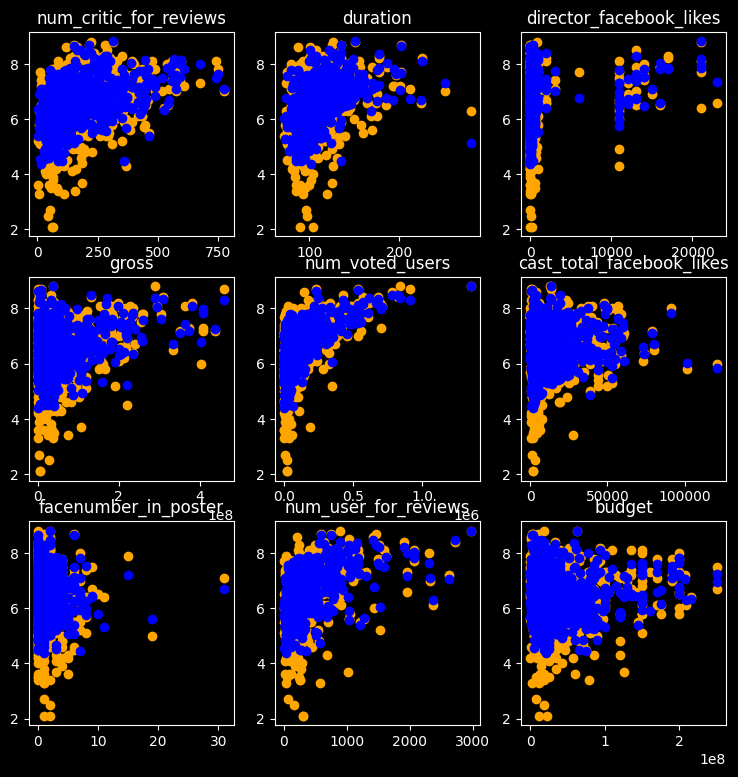

In [21]:
from sklearn.ensemble import GradientBoostingRegressor

regr = GradientBoostingRegressor(learning_rate=0.05, max_depth=5,
                          min_samples_leaf=2, min_samples_split=5,
                          n_estimators=300, random_state=0)

y_pred = regr.fit(X_train, y_train).predict(X_test)

gboostTunedR2 = r2_score(y_test, y_pred)

print("R2 score: " + str(gboostTunedR2))

rows, columns = 3, 3
figure, axis = plt.subplots(3, 3, figsize=(9, 9))

# plot the test and predicted values for each of the features

for row, column in itertools.product(range(rows), range(columns)):

    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_test, color="orange"
    )
    axis[row, column].scatter(
        X_test.iloc[:, row * columns + column], y_pred, color="blue"
    )
    axis[row, column].set_title(X_test.columns[row * columns + column])

plt.show()

In [11]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.05, 0.1, 0.2],
    'max_depth': [3, 4, 5],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
}

grid_search = GridSearchCV(
    estimator=regr,
    param_grid=param_grid,
    cv=5,
    scoring="r2",
)

# Perform the grid search
grid_search.fit(X_train, y_train)

# Get the best parameters and best estimator
best_params = grid_search.best_params_
best_estimator = grid_search.best_estimator_


In [41]:
print(best_params)
print(best_estimator)

# {'learning_rate': 0.05, 'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 300}
# GradientBoostingRegressor(learning_rate=0.05, max_depth=5, max_features='sqrt', min_samples_leaf=2, min_samples_split=5, n_estimators=300, random_state=0)

{'learning_rate': 0.05, 'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 300}
GradientBoostingRegressor(learning_rate=0.05, max_depth=5, max_features='sqrt',
                          min_samples_leaf=2, min_samples_split=5,
                          n_estimators=300, random_state=0)


## Results Analysis and Conclusion

We have trained different models, with different success degrees. What we can see from the graphs, is that all models, altough with different degree, have difficulty reaching the lower-left corner values. That is, there is a set of outliers in an area with high data divergence, that is difficult to regress for.

Overall the data set seems hard to predict for the lower range of features, where there is more variance in the labels or outcomes.

c:\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Python311\Lib\site-packages\seaborn\_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
c:\Python311\Lib\site-pa

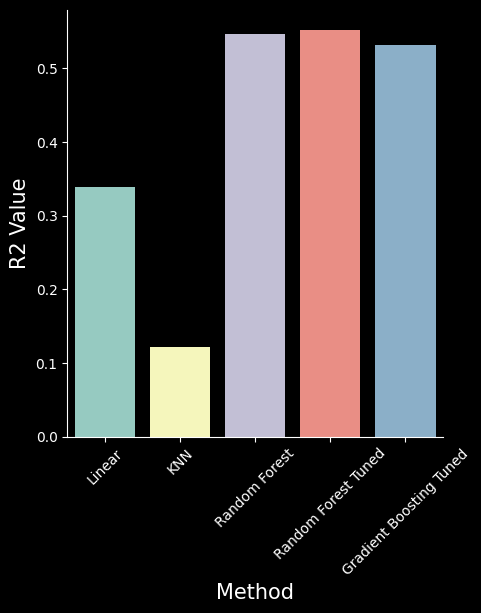

<Figure size 1000x300 with 0 Axes>

In [40]:
results_df = pd.DataFrame([
    ["Linear", linearR2],
    ["KNN", knnR2],
    ["Random Forest", rForestR2],
    ["Random Forest Tuned", rForestTunedR2],
    ["Gradient Boosting Tuned", gboostTunedR2],
], columns=["x", "y"])

sns.catplot(results_df, x="x", y="y", kind="bar")
plt.xticks(rotation=45)
plt.xlabel('Method', fontsize=15)
plt.ylabel('R2 Value', fontsize=15)
plt.figure(figsize=(10,3))
plt.show()